### Exploratory Data Analysis - Cleaned.csv

**Overview of EDA**
- Understand distribution and issues in processed data
- Assess geographical distribution via network latency
- Explore time-series behaviour of latency
- Justify feature engineering decisions by comparing latency measures (svr1-4)

In [5]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import geopandas as gpd
import plotly.express as px

In [6]:
try:
    import contextily as ctx
    HAS_CTX = True
except ImportError:
    HAS_CTX = False

### Load

In [7]:
df = pd.read_csv('data/Cleaned.csv', parse_dates=['datetime'], infer_datetime_format=True)

C:\Users\User\AppData\Local\Temp\ipykernel_21808\3128687428.py:1: FutureWarning: The argument 'infer_datetime_format' is deprecated and will be removed in a future version. A strict version of it is now the default, see https://pandas.pydata.org/pdeps/0004-consistent-to-datetime-parsing.html. You can safely remove this argument.
  df = pd.read_csv('data/Cleaned.csv', parse_dates=['datetime'], infer_datetime_format=True)


In [8]:
sample_size = 150_000
df = df if len(df) <= sample_size else df.sample(n=sample_size, random_state=42)

In [9]:
df.head(10)

,Day,Year,Month,Date,hour,min,sec,timezone,latitude,longitude,...,cwnd_unit,Role-RX,Transfer size-RX,Transfer unit-RX,Bitrate-RX,bitrate_unit-RX,send_data,square_id,datetime,day_of_week
826843,Fri,2022.0,7.0,8.0,10,12.0,26.0,AEST,-37.786934,144.770231,...,MBytes,RX-C,0.215820,MBytes,1.81,Mbits/sec,0.099766,square_51539607619,2022-07-08 10:12:26+10:00,4
1820415,Tue,2022.0,7.0,19.0,9,2.0,9.0,AEST,-37.789284,144.819068,...,MBytes,RX-C,0.000000,MBytes,0.00,Mbits/sec,NaN,square_51539607575,2022-07-19 09:02:09+10:00,1
605059,Thu,2022.0,7.0,7.0,8,2.0,22.0,AEST,-37.740321,144.798856,...,MBytes,RX-C,1.010000,MBytes,8.47,Mbits/sec,0.000000,square_85899345998,2022-07-07 08:02:22+10:00,3
1072102,Tue,2022.0,7.0,12.0,9,45.0,28.0,AEST,-37.794126,144.829514,...,MBytes,RX-C,0.000000,MBytes,0.00,Mbits/sec,0.000000,square_51539607579,2022-07-12 09:45:28+10:00,1
1787369,Tue,2022.0,7.0,19.0,7,0.0,7.0,AEST,-37.784626,144.798834,...,MBytes,RX-C,0.966797,MBytes,8.11,Mbits/sec,0.158718,square_51539607629,2022-07-19 07:00:07+10:00,1
604029,Thu,2022.0,7.0,7.0,7,44.0,23.0,AEST,-37.737395,144.804210,...,MBytes,RX-C,1.920000,MBytes,16.10,Mbits/sec,0.003142,square_94489280569,2022-07-07 07:44:23+10:00,3
1463542,Thu,2022.0,7.0,14.0,9,26.0,56.0,AEST,-37.725627,144.765143,...,MBytes,RX-C,1.740000,MBytes,14.60,Mbits/sec,1.022375,square_103079215130,2022-07-14 09:26:56+10:00,3
2194789,Fri,2022.0,7.0,22.0,11,7.0,16.0,AEST,-37.790592,144.755131,...,MBytes,RX-C,3.770000,MBytes,31.70,Mbits/sec,0.142659,square_51539607558,2022-07-22 11:07:16+10:00,4
2144985,Thu,2022.0,7.0,21.0,9,38.0,43.0,AEST,-37.712934,144.829340,...,MBytes,RX-C,0.875000,MBytes,7.34,Mbits/sec,NaN,square_111669149762,2022-07-21 09:38:43+10:00,3
2245220,Fri,2022.0,7.0,22.0,11,22.0,28.0,AEST,-37.769841,144.773252,...,MBytes,RX-C,2.640000,MBytes,22.10,Mbits/sec,0.000000,square_68719476746,2022-07-22 11:22:28+10:00,4


In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 150000 entries, 826843 to 905119
Data columns (total 33 columns):
 #   Column            Non-Null Count   Dtype                    
---  ------            --------------   -----                    
 0   Day               150000 non-null  object                   
 1   Year              150000 non-null  float64                  
 2   Month             150000 non-null  float64                  
 3   Date              150000 non-null  float64                  
 4   hour              150000 non-null  int64                    
 5   min               150000 non-null  float64                  
 6   sec               150000 non-null  float64                  
 7   timezone          150000 non-null  object                   
 8   latitude          150000 non-null  float64                  
 9   longitude         150000 non-null  float64                  
 10  speed             150000 non-null  float64                  
 11  truck             150000 n

In [11]:
print(df.describe())

           Year     Month           Date           hour            min  \
count  150000.0  150000.0  150000.000000  150000.000000  150000.000000   
mean     2022.0       7.0      12.243180       8.810613      29.405440   
std         0.0       0.0       5.983934       2.225604      17.477149   
min      2022.0       7.0       4.000000       4.000000       0.000000   
25%      2022.0       7.0       6.000000       7.000000      14.000000   
50%      2022.0       7.0      12.000000       9.000000      29.000000   
75%      2022.0       7.0      18.000000      11.000000      45.000000   
max      2022.0       7.0      22.000000      16.000000      59.000000   

                 sec       latitude      longitude          speed  \
count  150000.000000  150000.000000  150000.000000  150000.000000   
mean       29.609193     -37.753888     144.796849      14.661525   
std        17.292212       0.033544       0.032094      23.215308   
min         0.000000     -37.828817     144.718100       

### Geographical Scatter (altered original by Savindu)

**Explanation**
- shows distribution of measurement points (using longtitude vs. latitude)
- data points displayed broader for quick overview of an area
- latency measured by svr1 displayed in different colors 
- *why svr1* to be justified later in the EDA

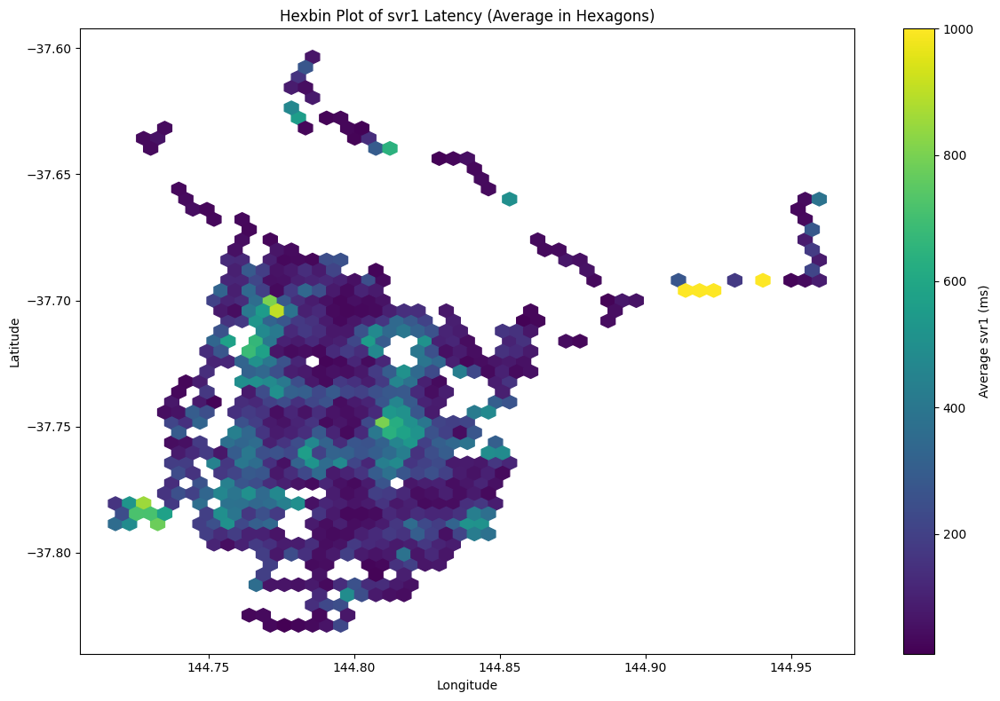

In [12]:
plt.figure(figsize=(12, 8))
hb = plt.hexbin(df['longitude'], df['latitude'], C=df['svr1'], 
                gridsize=50, cmap='viridis', reduce_C_function=np.mean)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Hexbin Plot of svr1 Latency (Average in Hexagons)')
cbar = plt.colorbar(hb)
cbar.set_label('Average svr1 (ms)')
plt.tight_layout()
plt.show()

### Interactive map with Plotly

**Explanation**
- using plotly map tool for interactive features
- tooltip hover for data attributes

In [13]:
df_sample_interactive = df.dropna(subset=['latitude', 'longitude', 'svr1', 'square_id'])

# get average latency (svr1) and other metrics for each unique location (latitude, longitude)
df_agg = df_sample_interactive.groupby(['latitude', 'longitude'], as_index=False).agg({
    'svr1': 'mean',      
    'speed': 'mean',     
    'square_id': 'first',
    'truck': 'first'     
})

fig = px.scatter_map(
    df_agg,
    lat='latitude',
    lon='longitude',
    color='svr1',         # color-code by averaged latency (svr1)
    size='svr1',          # marker size also reflects average latency
    size_max=20,
    zoom=10,
    title='Interactive Map: Aggregated Latency (svr1) Across Locations',
    hover_data={
        'svr1': True,
        'speed': True,
        'square_id': True,
        'truck': True
    },
    width=1200,           
    height=800            
)

fig.show()

### Geospatial Mapping by square_id

**Explanation**
- convert sampled data into GeoDataFrame for mapping
- points are plotted to map
- displaying data by 'square_id' for zone identification
- basemap context for geographic

c:\Users\User\Documents\SWINBURNE\Melbourne\Sem 5\COS40007\5G_Network_Performance\.venv\Lib\site-packages\joblib\memory.py:577: UserWarning:

Persisting input arguments took 0.91s to run.If this happens often in your code, it can cause performance problems (results will be correct in all cases). The reason for this is probably some large input arguments for a wrapped function.



KeyboardInterrupt: 

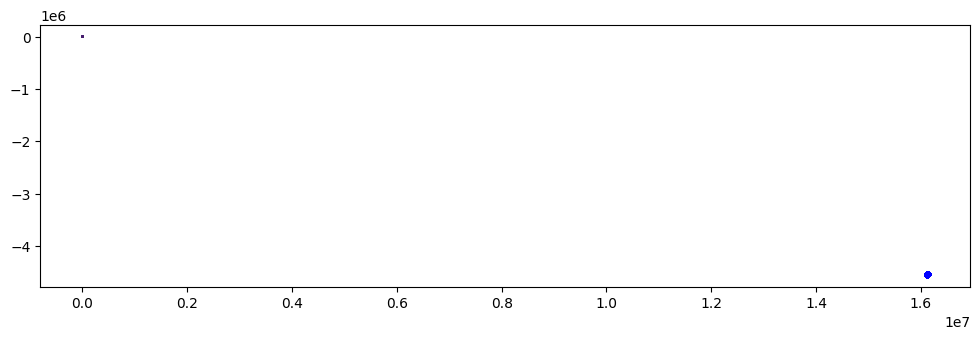

In [ ]:
gdf = gpd.GeoDataFrame(
    df,
    geometry=gpd.points_from_xy(df['longitude'], df['latitude']),
    crs='EPSG:4326'
).to_crs(epsg=3857) 

square_agg = df.groupby('square_id').agg({'svr1': 'mean', 'latitude': 'mean', 'longitude': 'mean'})

fig, ax = plt.subplots(figsize=(12, 12))
gdf.plot(ax=ax, alpha=0.5, markersize=10, color='blue') 

# Scatter plot for aggregated data
sc = ax.scatter(
    square_agg['longitude'], 
    square_agg['latitude'], 
    c=square_agg['svr1'], 
    s=1,  
    cmap='viridis'
)


if HAS_CTX:
    ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik, zoom=12)  


plt.colorbar(sc, label='svr1 (ms)')
plt.title('Cleaned Data: Average Latency by Square Zone')
ax.set_axis_off()
plt.tight_layout()
plt.show()

### Time Series 

**Explanation**
- shows time-series behaviour of svr1 latency
- reveals variability and potential outliers and helps decide how to resample or clean the data later

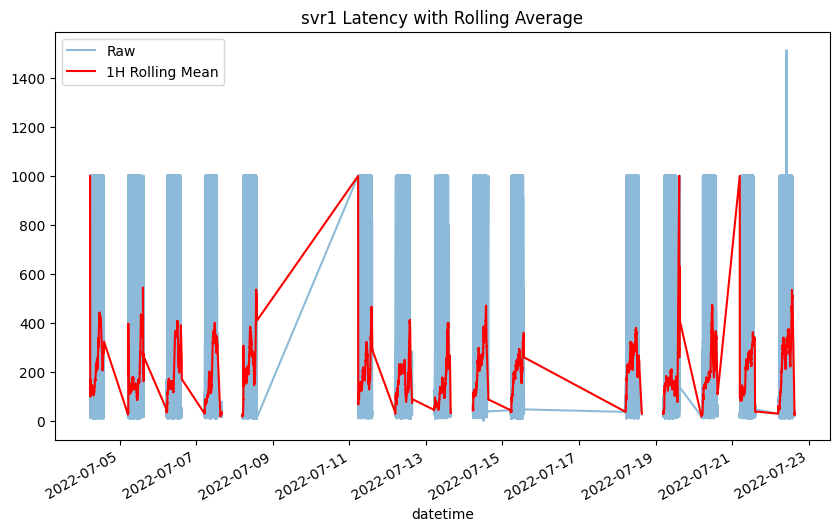

In [14]:
# Ensure the DataFrame is sorted by datetime
df = df.sort_values(by='datetime')

# Plot the time series with rolling mean
plt.figure(figsize=(10, 6))
ax = df.set_index('datetime')['svr1'].plot(alpha=0.5, label='Raw')
df.set_index('datetime')['svr1'].rolling('1h').mean().plot(ax=ax, color='red', label='1H Rolling Mean')
plt.legend()
plt.title('svr1 Latency with Rolling Average')
plt.show()

### Speed Distribution

**Explanation**
- shows the distribution of truck speeds
- reveals if there are unrealistic speed values and how speed might relate to network performance

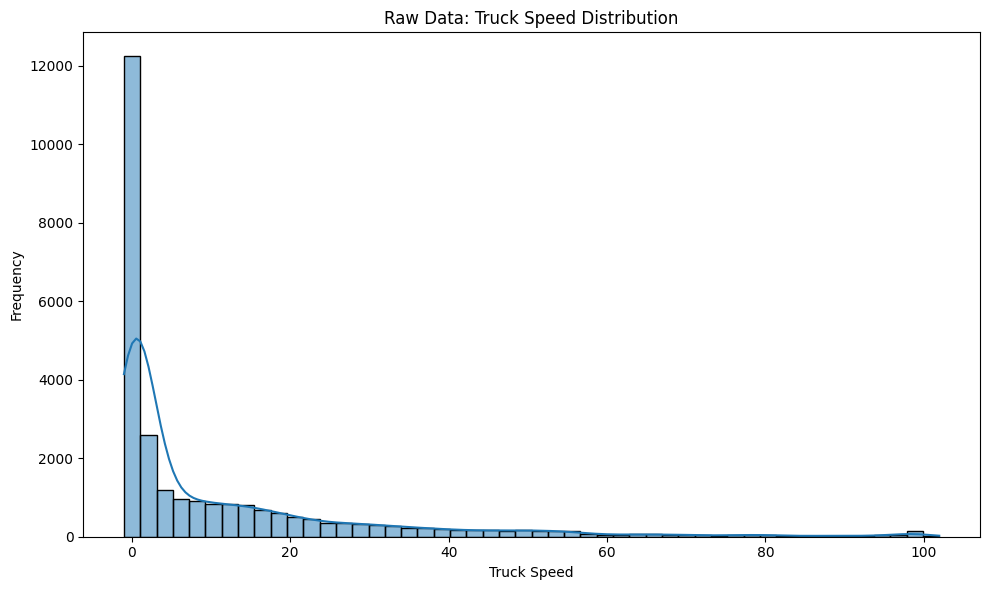

In [ ]:
plt.figure(figsize=(10, 6))
sns.histplot(df['speed'].dropna(), bins=50, kde=True)
plt.xlabel('Truck Speed')
plt.ylabel('Frequency')
plt.title('Truck Speed Distribution')
plt.tight_layout()
plt.show()

### SVR1 Distribution

**Explanation**
- same as previous one except for SVR1 latency
- also reveals unrealistic distribution and pattern of latency

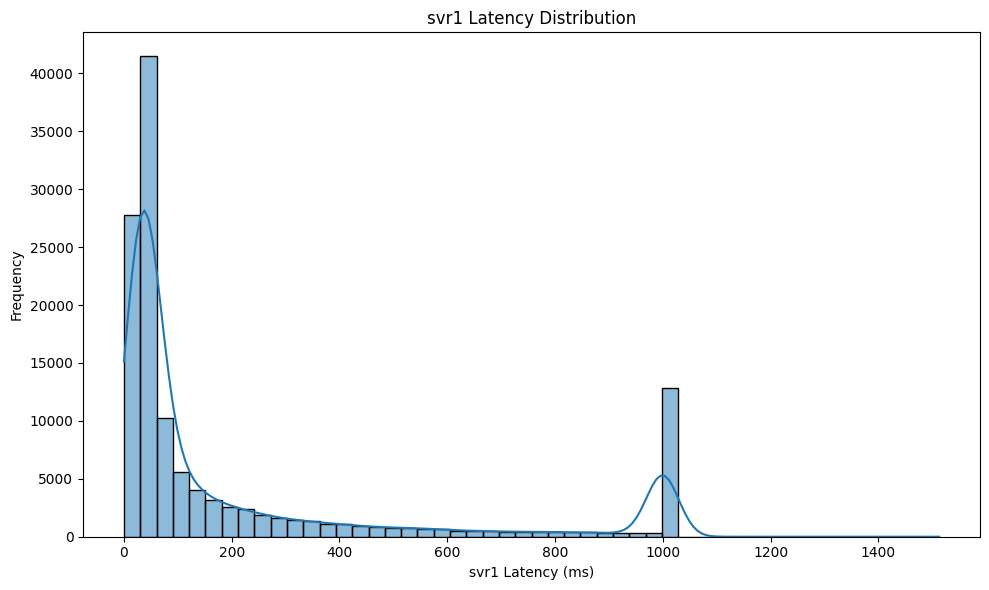

In [15]:
plt.figure(figsize=(10, 6))
sns.histplot(df['svr1'].dropna(), bins=50, kde=True)
plt.xlabel('svr1 Latency (ms)')
plt.ylabel('Frequency')
plt.title('svr1 Latency Distribution')
plt.tight_layout()
plt.show()

### Bar Chart of Average Latency via square_id

**Explanation**
- show average network performances in each zone via square_id
- sorting by latency
- supports spatial clustering by highlighting differences across zone

C:\Users\User\AppData\Local\Temp\ipykernel_21808\3466133340.py:4: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




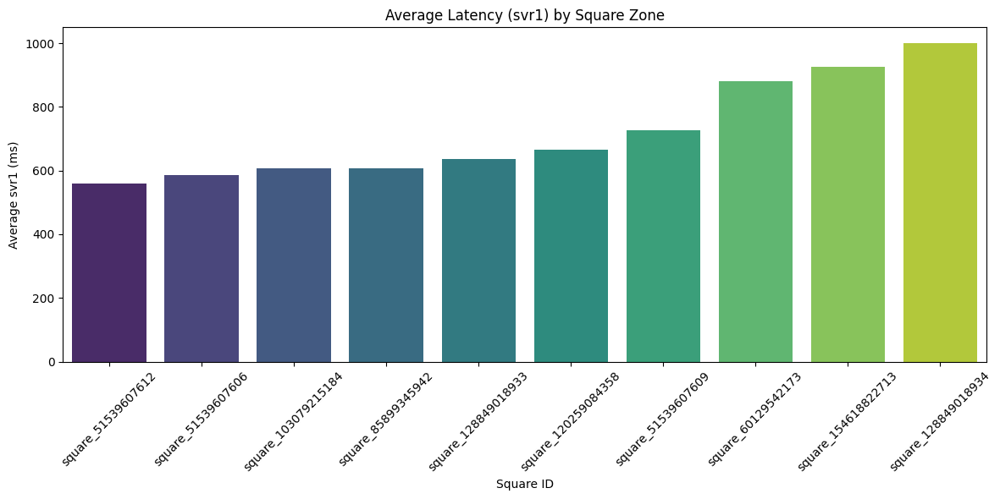

In [22]:
square_agg = df.dropna(subset=['svr1']).groupby('square_id')['svr1'].mean().reset_index().sort_values(by='svr1')
top_square_agg = square_agg.tail(10)
plt.figure(figsize=(12, 6))
sns.barplot(data=top_square_agg, x='square_id', y='svr1', palette='viridis')
plt.xlabel('Square ID')
plt.ylabel('Average svr1 (ms)')
plt.title('Average Latency (svr1) by Square Zone')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

### Latency Correlation Matrix

**Explanation**
- heatmap displays correlations among latency measures: svr1-4
- high correlation justifies why only svr1 is extracted for modelling
- this approach reduces redundancy (prevent overfitting too) and complexity (code optimisation)

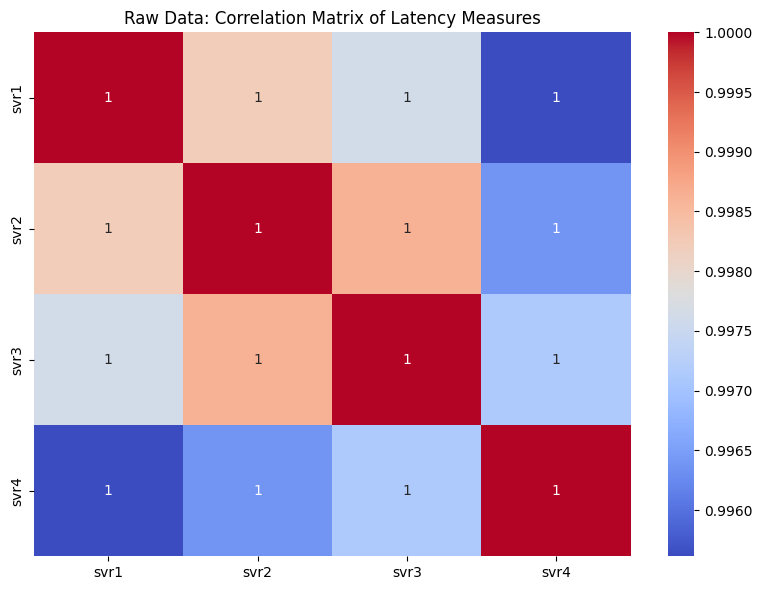

In [ ]:
plt.figure(figsize=(8, 6))
latency_cols = ['svr1', 'svr2', 'svr3', 'svr4']
sns.heatmap(df[latency_cols].corr(), annot=True, cmap='coolwarm')
plt.title('Correlation Matrix of Latency Measures')
plt.tight_layout()
plt.show()